**Loading the model from pretrained model resnet18**

In [1]:
import torch
import torchvision.models as models 
import torchsummary

import torch

model = torch.hub.load('pytorch/vision:v0.10.0', 'resnet18', pretrained =True)        
model.eval()

model.to('cuda')
torchsummary.summary(model, (3,150,150), device='cuda')

Using cache found in C:\Users\sjwoo/.cache\torch\hub\pytorch_vision_v0.10.0


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 75, 75]           9,408
       BatchNorm2d-2           [-1, 64, 75, 75]             128
              ReLU-3           [-1, 64, 75, 75]               0
         MaxPool2d-4           [-1, 64, 38, 38]               0
            Conv2d-5           [-1, 64, 38, 38]          36,864
       BatchNorm2d-6           [-1, 64, 38, 38]             128
              ReLU-7           [-1, 64, 38, 38]               0
            Conv2d-8           [-1, 64, 38, 38]          36,864
       BatchNorm2d-9           [-1, 64, 38, 38]             128
             ReLU-10           [-1, 64, 38, 38]               0
       BasicBlock-11           [-1, 64, 38, 38]               0
           Conv2d-12           [-1, 64, 38, 38]          36,864
      BatchNorm2d-13           [-1, 64, 38, 38]             128
             ReLU-14           [-1, 64,

**Preprocessing and displaying image**

In [2]:
import urllib.request 
from PIL import Image 
import numpy as np
import matplotlib.pyplot as plt

urllib.request.urlretrieve( 
  'https://img-datasets.s3.amazonaws.com/cat.jpg',"cat.jpg") 
  
img = Image.open("cat.jpg") 
img = img.resize([224,224])
img_tensor = np.array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
input_img_tensor = torch.tensor(img_tensor, dtype=torch.float32).permute(0, 3, 1, 2)

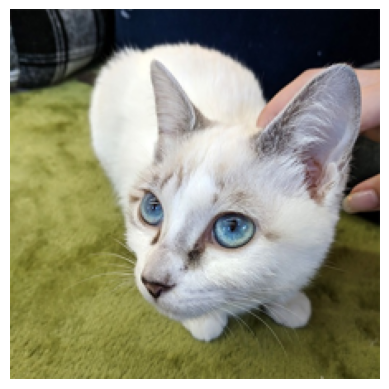

In [3]:
import matplotlib.pyplot as plt
plt.axis("off")
plt.imshow(img_tensor[0].astype("uint8"))
plt.show()

**Instantiating a model that returns layer activations**

In [4]:
import torch.nn as nn

for name, layer in model._modules.items():
    print(name)
    print(layer)

visualization = {}

def hook(name):
    def fn(module, inputs, outputs):
        visualization[name] = outputs 
    return fn
    
for name, layer in model._modules.items():
    layer.register_forward_hook(hook(name))

conv1
Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
bn1
BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
relu
ReLU(inplace=True)
maxpool
MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
layer1
Sequential(
  (0): BasicBlock(
    (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (1): BasicBlock(
    (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1

**Visualizing the activation layer(RELU) in Conv1 block**

dict_keys(['conv1', 'bn1', 'relu', 'maxpool', 'layer1', 'layer2', 'layer3', 'layer4', 'avgpool', 'fc'])
torch.Size([1, 64, 112, 112])


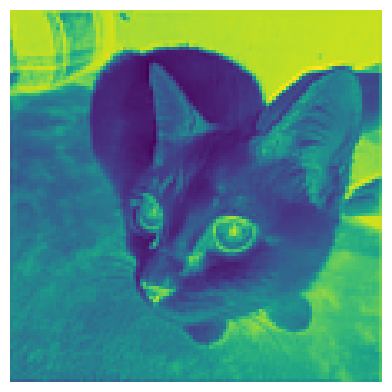

In [20]:
import matplotlib.pyplot as plt
model.to('cpu')
with torch.no_grad():
    out = model(input_img_tensor)
print(visualization.keys())

print(visualization['conv1'].shape)
plt.matshow(visualization['conv1'][0, 3, :, :], cmap='viridis')
plt.axis("off")
plt.show()

**Visualizing every channel in every intermediate layers**

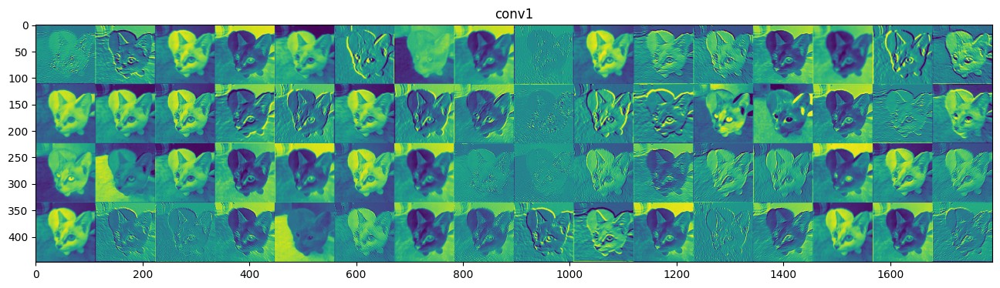

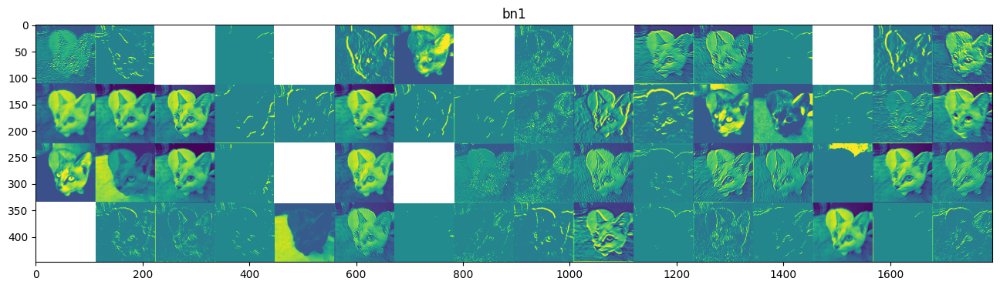

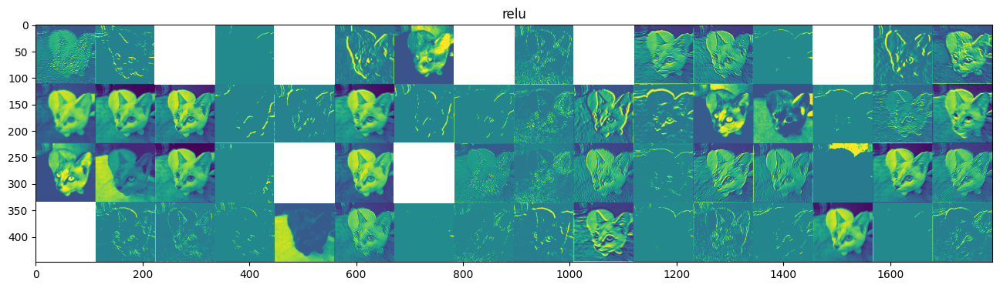

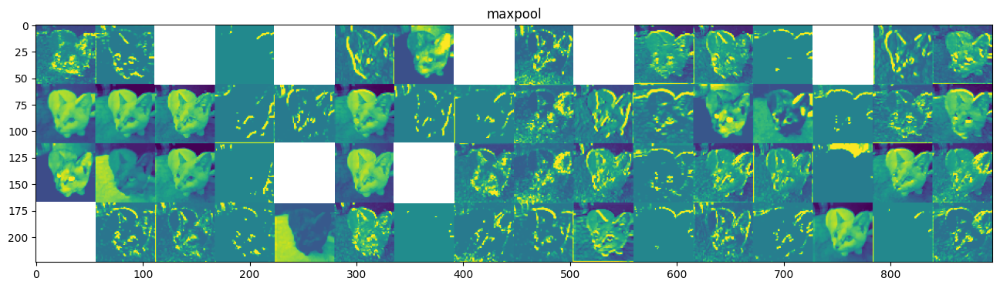

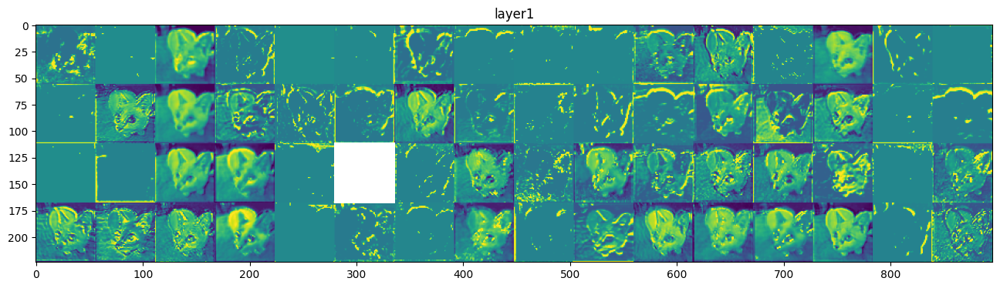

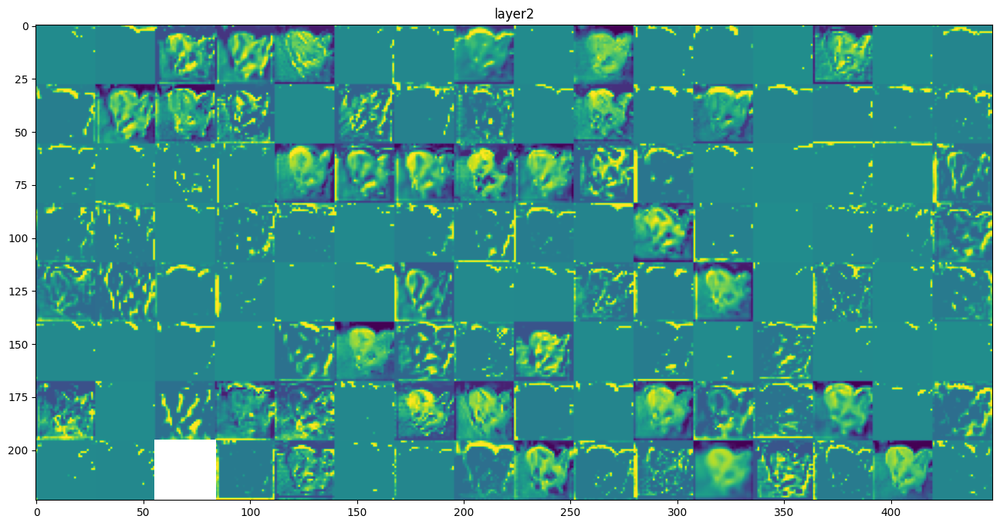

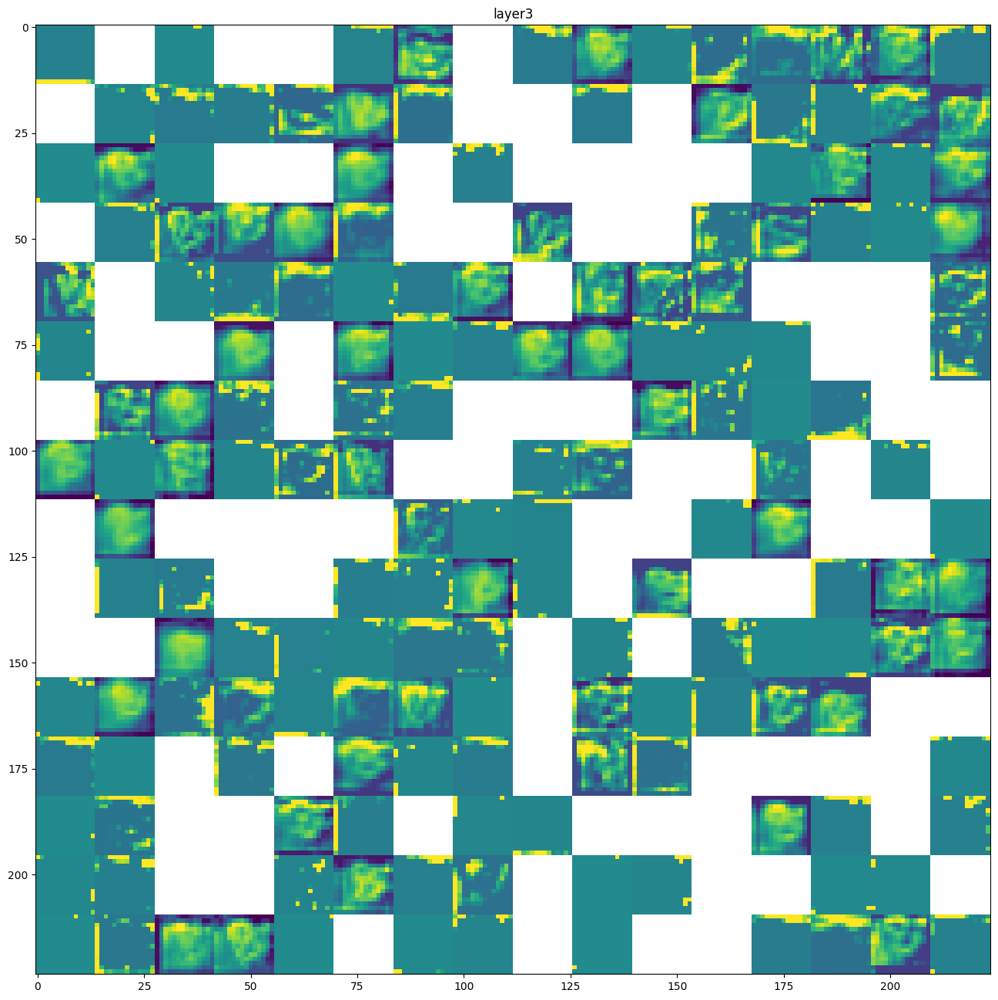

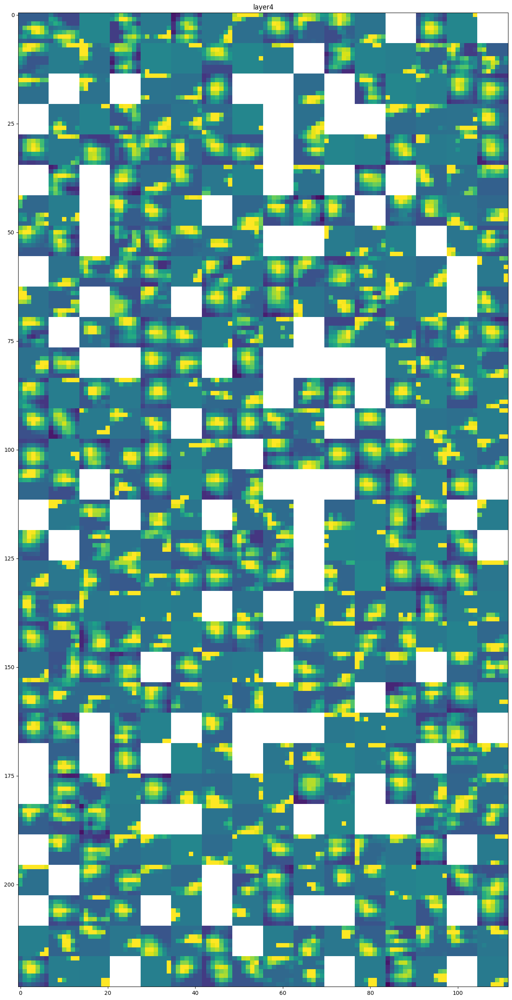

In [23]:
images_per_row = 16

for layer_name in visualization.keys():
    if layer_name == 'avgpool':
        break
    layer_activation = visualization[layer_name]
    n_features = layer_activation.shape[1]

    size = layer_activation.shape[2]

    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))

    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0,
                                             col * images_per_row + row, :, :
                                             ]
                    
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255)
            display_grid[col * size : (col + 1) * size,
                         row * size : (row + 1) * size] = channel_image

    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')
   
plt.show()

**Instantiating the VGG16 convolutional base**

In [8]:
import torchvision.models as models
from torchvision import utils

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

vgg16 = models.vgg16(pretrained = True).to(device)
vgg16.eval()

for name, layer in vgg16.features._modules.items():
    print(name)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [9]:
def deprocess_image(x):
    # normalize tensor: center on 0., ensure std is 0.1
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1

    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
    x *= 255
    x = np.clip(x, 0, 255)
    return x.int()

**Loss maximization via stochastic gradient ascent**

In [10]:
criterion = nn.MSELoss()

def generate_pattern(layer_name, filter_index, size=150):
    # Build a loss function that maximizes the activation
    # of the nth filter of the layer considered.

    # Compute the gradient of the input picture wrt this loss

    # Normalization trick: we normalize the gradient
    # grads /= (torch.sqrt(torch.mean(torch.square(grads))) + 1e-5)

    def compute(model, x, layer_name):
        for name, layer in model.features._modules.items():
            x = layer(x)
            if name == layer_name:
                return x
    

    # We start from a gray image with some noise
    input_img_data = torch.rand((1, 3, size, size)).to(device).requires_grad_(True)

    # Run gradient ascent for 40 steps
    step = 1.
    for i in range(40):
        outputs = compute(vgg16, input_img_data, layer_name)
        outputs = outputs[0, filter_index, :, :]
        
        loss = criterion(outputs.mean(), torch.zeros_like(outputs.mean()))
        loss.backward()

        # print(input_img_data.grad)
        input_img_data = (input_img_data + input_img_data.grad * step)
        input_img_data.retain_grad()
        
    img = input_img_data[0].cpu().detach()
    img = img.permute(1, 2, 0)
    # print(img.shape)
    return deprocess_image(img)

**Utility function to convert a tensor into a valid image**

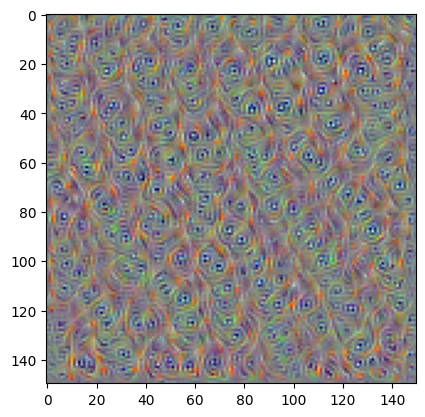

In [11]:
plt.imshow(generate_pattern('15', 2))
plt.show()

**Generating a grid of all filter response patterns in a layer**

c:\Users\sjwoo\anaconda3\envs\2023ADL\lib\site-packages\ipykernel_launcher.py:6: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  


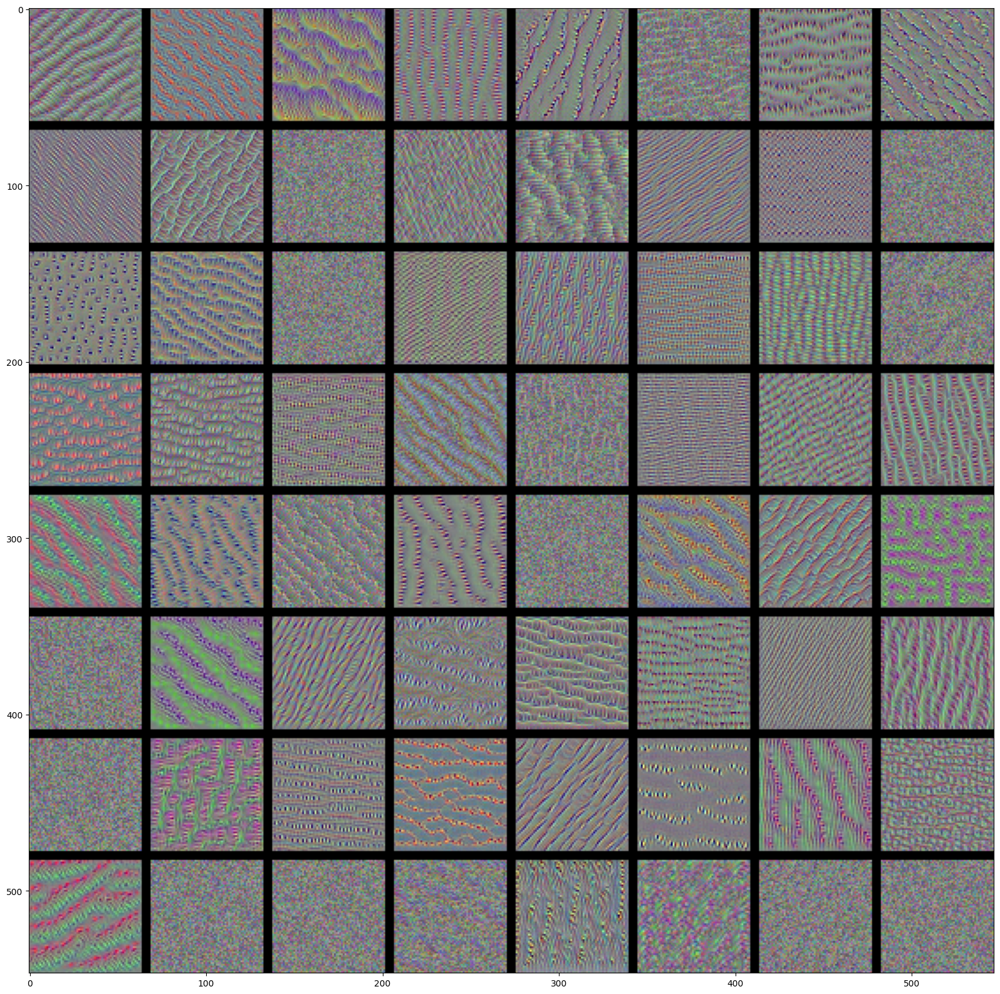

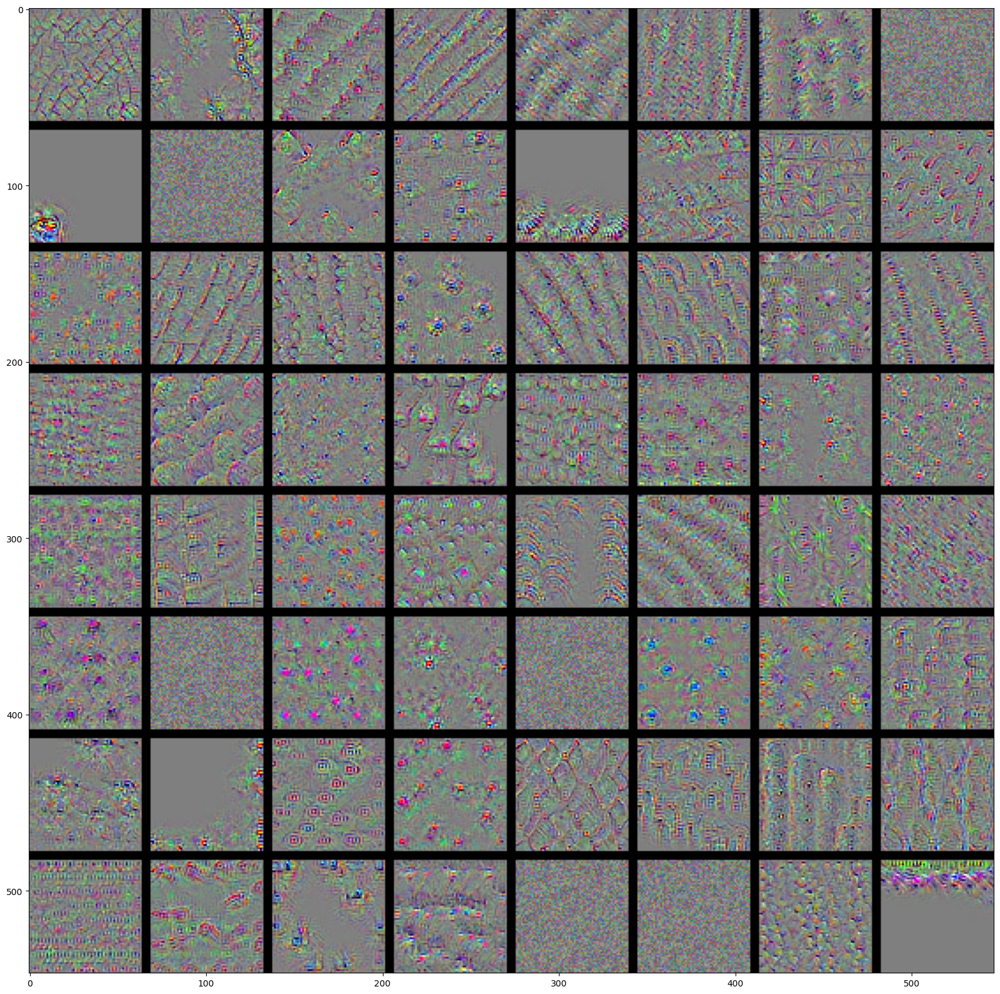

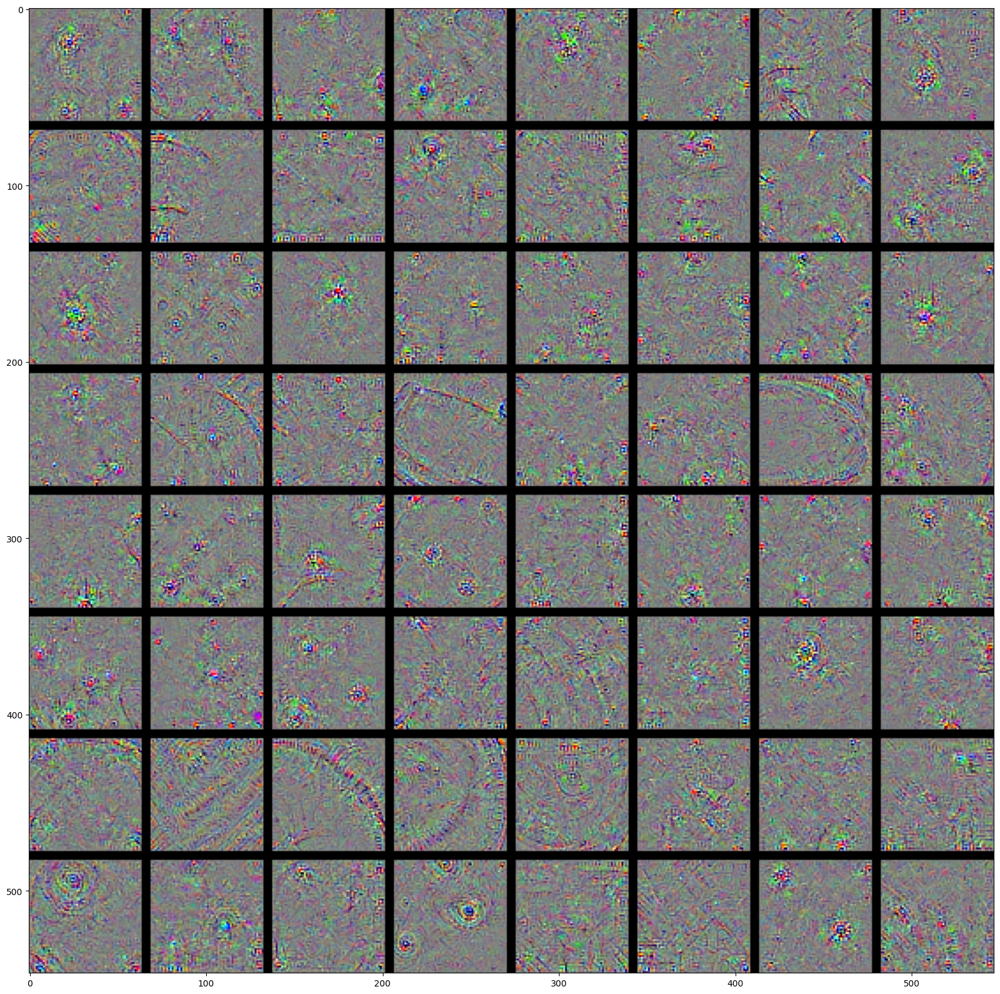

In [25]:
for layer_name in ['8', '16', '24']:
    size = 64
    margin = 5

    # This a empty (black) image where we will store our results.
    results = np.zeros((8 * size + 7 * margin, 8 * size + 7 * margin, 3), dtype=np.int)

    for i in range(8):  # iterate over the rows of our results grid
        for j in range(8):  # iterate over the columns of our results grid
            # Generate the pattern for filter `i + (j * 8)` in `layer_name`
            filter_img = generate_pattern(layer_name, i + (j * 8), size=size)

            # Put the result in the square `(i, j)` of the results grid
            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            results[horizontal_start: horizontal_end, vertical_start: vertical_end, :] = filter_img

    # Display the results grid
    plt.figure(figsize=(20, 20))
    plt.imshow(results)


**Loading the VGG16 network with pretrained weights  & Preprocessing an input image for VGG16**

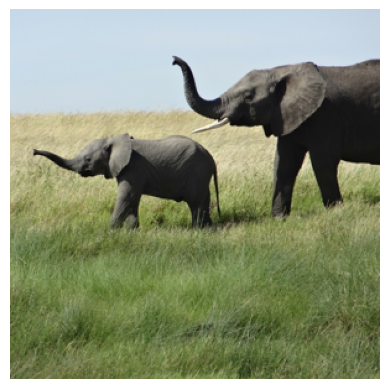

In [13]:
urllib.request.urlretrieve( 
  'https://img-datasets.s3.amazonaws.com/elephant.jpg',"elephant.jpg") 

elephant_img = Image.open("elephant.jpg") 
elephant_img = elephant_img.resize([299,299])
elephant_img_tensor = np.array(elephant_img)
elephant_img_tensor = np.expand_dims(elephant_img_tensor, axis=0)
elephant_input_img_tensor = torch.tensor(elephant_img_tensor, dtype=torch.float32).permute(0, 3, 1, 2)

import matplotlib.pyplot as plt
plt.axis("off")
plt.imshow(elephant_img_tensor[0].astype("uint8"))
plt.show()

**Retrieving the gradients of the top predicted class**

In [14]:
import torch.nn.functional as F

# activations
feature_blobs = []

# gradients
backward_feature = []

# output으로 나오는 feature를 feature_blobs에 append하도록
def hook_feature(module, input, output):
    feature_blobs.append(output.cpu().data.numpy())
    
# Grad-CAM
def backward_hook(module, input, output):
    backward_feature.append(output[0])
    
vgg16._modules.get('features').register_forward_hook(hook_feature)
vgg16._modules.get('features').register_backward_hook(backward_hook)

logit = vgg16(elephant_input_img_tensor.to(device))
h_x = F.softmax(logit, dim=1).data.squeeze()
probs, idx = h_x.sort(0, True)

c:\Users\sjwoo\anaconda3\envs\2023ADL\lib\site-packages\torch\nn\modules\module.py:1025: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


In [15]:
score = logit[:, idx[0]].squeeze() # 예측값 y^c
score.backward(retain_graph = True) # 예측값 y^c에 대해서 backprop 진행

activations = torch.Tensor(feature_blobs[0]).to(device) # (1, 512, 4, 4), forward activations
gradients = backward_feature[0] # (1, 512, 7, 7), backward gradients
b, k, u, v = gradients.size()

alpha = gradients.view(b, k, -1).mean(2) # (1, 512, 4*4) => (1, 512), feature map k의 'importance'
weights = alpha.view(b, k, 1, 1) # (1, 512, 1, 1)

grad_cam_map = (weights*activations).sum(1, keepdim = True) # alpha * A^k = (1, 512, 4, 4) => (1, 1, 7, 7)
grad_cam_map = F.relu(grad_cam_map) # Apply R e L U
map_min, map_max = grad_cam_map.min(), grad_cam_map.max()
grad_cam_map = (grad_cam_map - map_min).div(map_max - map_min).data # (1, 1, 224, 224), min-max scaling

**Heatmap post-processing**

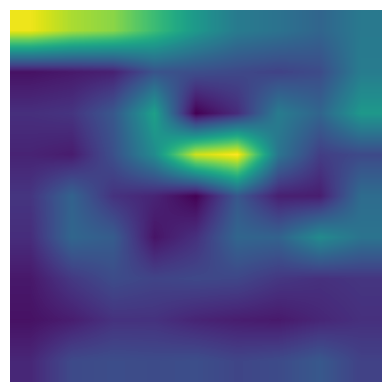

In [16]:
import cv2

img = cv2.imread("elephant.jpg")
# We resize the heatmap to have the same size as the original image
heatmap = cv2.resize(grad_cam_map.squeeze().cpu().numpy(), (img.shape[1], img.shape[0]))
# We convert the heatmap to RGB
heatmap = np.uint8(255 * heatmap)
plt.matshow(heatmap)
plt.axis("off")
plt.show()

**Superimposing the heatmap on the original picture**

In [18]:
# We apply the heatmap to the original image
heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
# 0.4 here is a heatmap intensity factor
superimposed_img = heatmap * 0.4 + img

# Save the image to disk
cv2.imwrite('./elephant_cam.jpg', superimposed_img)


True

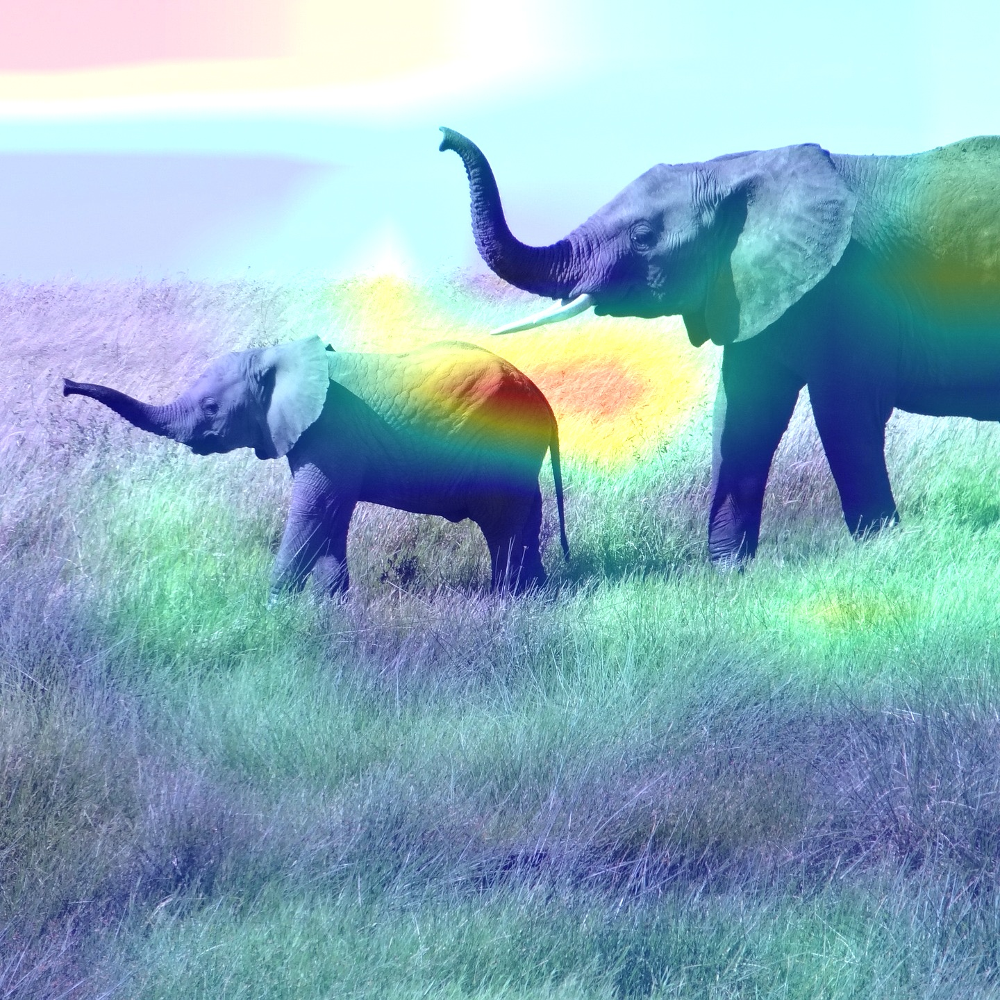